# Library

In [1]:
import os
import random
from PIL import Image,ImageOps
import numpy as np
from tqdm import tqdm
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from collections import defaultdict
from itertools import combinations, product
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt


In [2]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/gdrive')

ValueError: mount failed

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Data

In [ ]:
# dataset
path = "/content/gdrive/MyDrive/DissimilarityScore_Seeding/test1/"
path_1 = path + "Experiments_processed_BnW/"
path_2 = path + "Experiments_processed_color/"
path_3 = path + "Experiments_raw/"
path_4 = path + "Predictions/"
path_5 = path + "Simulations/"
path_6 = path + "Predictions_processed_BnW/"

# filename: ExpID_RepID.png
alldata_exp = [os.path.join(path_1, f) for f in os.listdir(path_1) if f.endswith(".TIF")]
alldata_exp_color = [os.path.join(path_2, f) for f in os.listdir(path_2) if f.endswith(".TIF")]
alldata_pred_color = [os.path.join(path_4, f) for f in os.listdir(path_4) if f.endswith(".png")]
alldata_sim = [os.path.join(path_5, f) for f in os.listdir(path_5) if f.endswith(".png")]
alldata_pred = [os.path.join(path_6, f) for f in os.listdir(path_6) if f.endswith(".png")]

print(len(alldata_sim))
print(len(alldata_pred))
print(len(alldata_pred_color))
print(len(alldata_exp))
print(len(alldata_exp_color))

100
100
100
100
100


# Dataset

In [ ]:
# Dataset for training siamese network
class SiamesePairsDataset(Dataset):
    def __init__(self, pairs, labels, transform=None):
        self.pairs = pairs
        self.labels = labels # binary
        self.transform = transform

    def __len__(self):
        return len(self.pairs)

    def __getitem__(self, idx):
        f1, f2 = self.pairs[idx]
        img1 = Image.open(f1).convert('L')
        img2 = Image.open(f2).convert('L')
        if self.transform:
            img1 = self.transform(img1)
            img2 = self.transform(img2)
        return img1, img2, torch.tensor(self.labels[idx], dtype=torch.float32)

# Generate balanced image pairs
def generate_pairs(alldata_sim, seed=42):
    random.seed(seed)
    group = defaultdict(list)
    for f in alldata_sim:
        expid = os.path.basename(f).split('_')[0]
        group[expid].append(f)

    # 1. Identical pairs -- replicates from the same experiments
    positive_pairs = []
    valid_expids = []
    for expid, files in group.items():
        if len(files) == 2:
            f1, f2 = files
            positive_pairs.append((f1, f2))
            valid_expids.append(expid)
        else:
            print(f"Skipping {expid}: {len(files)} replicates")

    # 2. Dissimilar pairs -- from different experiments
    negative_pairs = set()
    while len(negative_pairs) < len(positive_pairs):
        e1, e2 = random.sample(valid_expids, 2)
        f1 = random.choice(group[e1])
        f2 = random.choice(group[e2])
        pair = tuple(sorted((f1, f2)))
        negative_pairs.add(pair)

    negative_pairs = list(negative_pairs)

    # Combine
    all_pairs = positive_pairs + negative_pairs
    all_labels = [1] * len(positive_pairs) + [0] * len(negative_pairs)

    return all_pairs, all_labels

In [ ]:
# Generate training data and split
all_pairs, all_labels = generate_pairs(alldata_sim) # use binary simulation image pairs
split_ratio = 0.2
train_pairs, test_pairs, train_labels, test_labels = train_test_split(all_pairs, all_labels, test_size=split_ratio, random_state=42, stratify=all_labels)

# transform
transform = transforms.Compose([transforms.Resize((224, 224)), transforms.ToTensor()])

# create datasets and dataloaders
train_dataset = SiamesePairsDataset(train_pairs, train_labels, transform=transform)
test_dataset = SiamesePairsDataset(test_pairs, test_labels, transform=transform)

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

print(f"Total pairs: {len(all_pairs)} (Train: {len(train_dataset)}, Test: {len(test_dataset)})")

Skipping 219: 1 replicates
Skipping 220: 1 replicates
Skipping 213: 1 replicates
Skipping 239: 1 replicates
Total pairs: 96 (Train: 76, Test: 20)


# Train

In [ ]:
class SiameseNet(nn.Module):
    def __init__(self):
        super(SiameseNet, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(1, 16, 3), nn.ReLU(), nn.MaxPool2d(2),
            nn.Conv2d(16, 32, 3), nn.ReLU(), nn.MaxPool2d(2),
        )
        self.fc = nn.Sequential(
            nn.Linear(32 * 54 * 54, 128),
            nn.ReLU(),
            nn.Linear(128, 64)
        )

    def forward_once(self, x):
        x = self.conv(x)
        x = x.view(x.size(0), -1)
        return self.fc(x)

    def forward(self, x1, x2):
        out1 = self.forward_once(x1)
        out2 = self.forward_once(x2)
        return out1, out2

def contrastive_loss(out1, out2, label, margin=1.0):
    d = F.pairwise_distance(out1, out2)
    loss = torch.mean(label * torch.pow(d, 2) + (1 - label) * torch.pow(torch.clamp(margin - d, min=0.0), 2))
    return loss


In [ ]:
model = SiameseNet().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
epochs = 100
patience = 10  # early stopping
min_delta = 1e-4  # early stopping

best_test_loss = float('inf')
early_stop_counter = 0

for epoch in range(1, epochs + 1):
    # Train
    model.train()
    total_train_loss = 0
    for img1, img2, label in train_loader:
        img1, img2, label = img1.to(device), img2.to(device), label.to(device)
        out1, out2 = model(img1, img2)
        loss = contrastive_loss(out1, out2, label)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        total_train_loss += loss.item()

    avg_train_loss = total_train_loss / len(train_loader)

    # Validate
    model.eval()
    total_test_loss = 0
    with torch.no_grad():
        for img1, img2, label in test_loader:
            img1, img2, label = img1.to(device), img2.to(device), label.to(device)
            out1, out2 = model(img1, img2)
            loss = contrastive_loss(out1, out2, label)
            total_test_loss += loss.item()

    avg_test_loss = total_test_loss / len(test_loader)
    print(f"Epoch {epoch} | Train Loss: {avg_train_loss:.4f}, Test Loss: {avg_test_loss:.4f}")

    # Early stopping
    if avg_test_loss + min_delta < best_test_loss:
        best_test_loss = avg_test_loss
        early_stop_counter = 0
        torch.save(model.state_dict(), "best_model.pth")  # save best model
    else:
        early_stop_counter += 1
        if early_stop_counter >= patience:
            print(f"Early stopping.")
            break

Epoch 1 | Train Loss: 0.0956, Test Loss: 0.0000
Epoch 2 | Train Loss: 0.0000, Test Loss: 0.0000
Epoch 3 | Train Loss: 0.0000, Test Loss: 0.0000


KeyboardInterrupt: 

In [ ]:
model_dir = "/content/"
os.makedirs(model_dir, exist_ok=True)
model_path = os.path.join(model_dir, "model.pth")
torch.save(model, model_path)
print(f"Model saved to {model_path}")

Model saved to /content/model.pth


# Scoring

In [ ]:
def plot_test_pairs(model, data_loader, device, num_pairs=5):
    model.eval()
    shown = 0

    with torch.no_grad():
        for img1, img2, label in data_loader:
            img1, img2 = img1.to(device), img2.to(device)
            out1, out2 = model(img1, img2)
            distances = F.pairwise_distance(out1, out2).cpu().numpy()
            labels = label.numpy()
            imgs1 = img1.cpu()
            imgs2 = img2.cpu()

            for i in range(len(distances)):
                if shown >= num_pairs:
                    return
                fig, axs = plt.subplots(1, 2, figsize=(4, 2))
                axs[0].imshow(imgs1[i][0], cmap='gray')
                axs[0].set_title("Image 1")
                axs[0].axis('off')
                axs[1].imshow(imgs2[i][0], cmap='gray')
                axs[1].set_title("Image 2")
                axs[1].axis('off')
                if int(labels[i]) == 1:
                  label = "Identical"
                elif int(labels[i]) == 0:
                  label = "Different"
                plt.suptitle(f"Label: {label}, Dissimilarity: {distances[i]:.4f}")
                plt.tight_layout()
                plt.show()
                shown += 1


## Test set

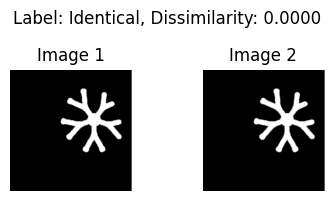

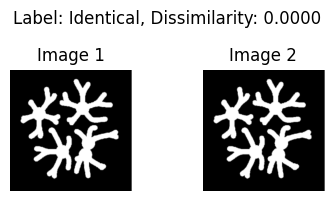

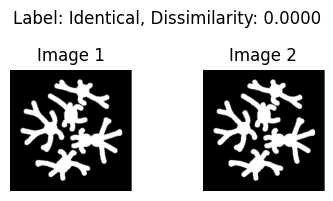

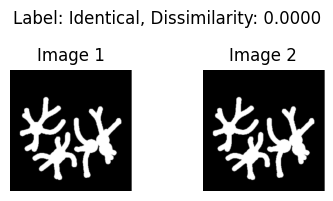

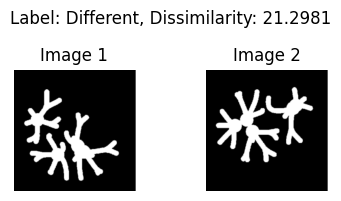

...

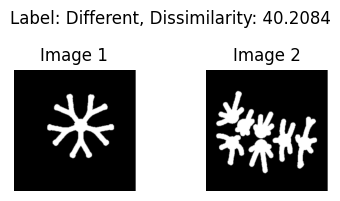

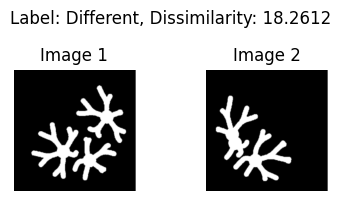

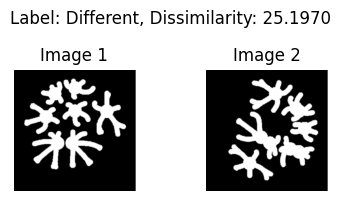

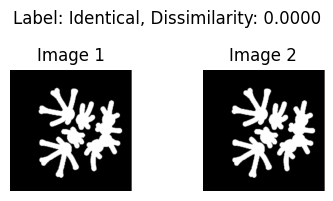

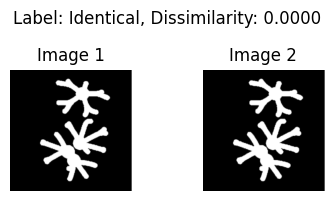

In [ ]:
# Plot dissimilarity scores on test sets
plot_test_pairs(model, test_loader, device, num_pairs=len(test_loader.dataset.pairs))


## Experiment set

Skipping 219: 1 replicates
Skipping 213: 1 replicates
Skipping 220: 1 replicates
Skipping 239: 1 replicates


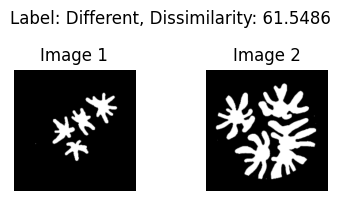

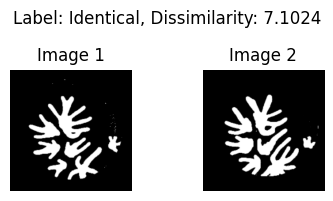

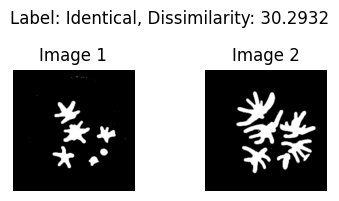

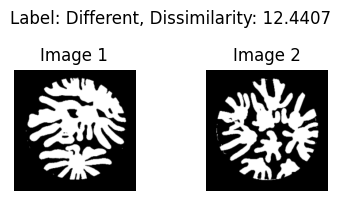

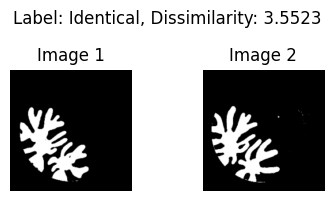

...

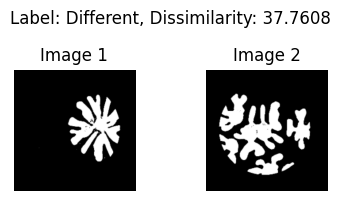

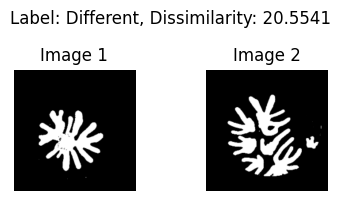

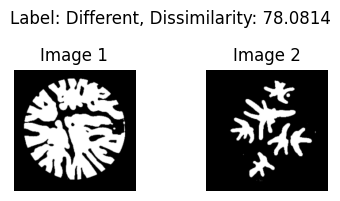

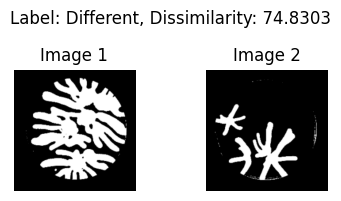

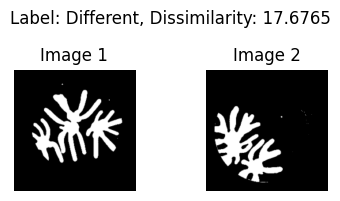

In [ ]:
# Now use the trained model on image pairs from different sources

# Generate balanced pairs from experimental data
exp_pairs, exp_labels = generate_pairs(alldata_exp, seed=0)

# Create Dataset and DataLoader
exp_dataset = SiamesePairsDataset(exp_pairs, exp_labels, transform=transform)
exp_loader = DataLoader(exp_dataset, batch_size=32, shuffle=True)

# Plot results

plot_test_pairs(model, exp_loader, device, num_pairs=len(exp_loader.dataset.pairs))


Skipping 219: 1 replicates
Skipping 213: 1 replicates
Skipping 220: 1 replicates
Skipping 239: 1 replicates


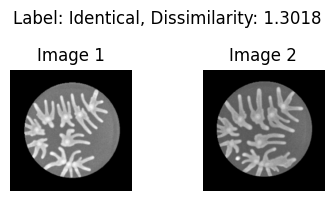

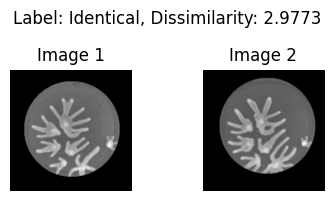

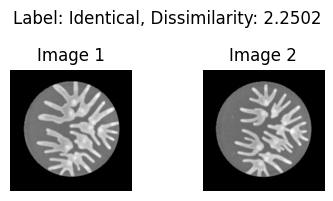

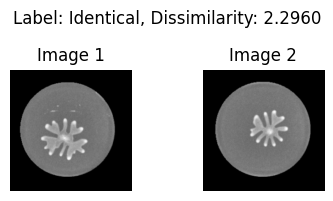

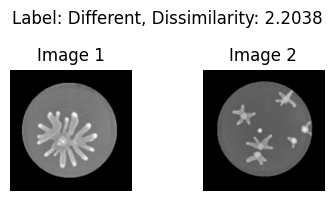

...

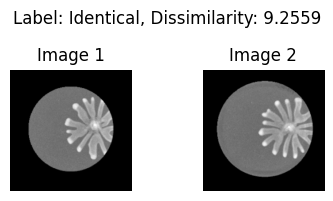

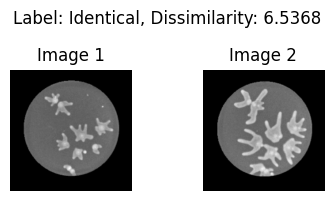

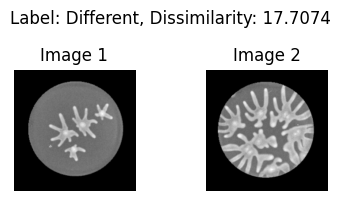

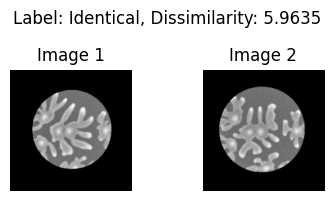

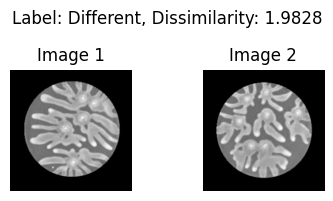

In [ ]:
# Generate balanced pairs from experimental data
exp_pairs_color, exp_labels_color = generate_pairs(alldata_exp_color, seed=0)

# Create Dataset and DataLoader
exp_dataset_color  = SiamesePairsDataset(exp_pairs_color, exp_labels_color , transform=transform)
exp_loader_color = DataLoader(exp_dataset_color , batch_size=32, shuffle=True)

# Plot results
plot_test_pairs(model, exp_loader_color, device, num_pairs=len(exp_loader_color.dataset.pairs))


## Simulation set

Skipping 219: 1 replicates
Skipping 220: 1 replicates
Skipping 213: 1 replicates
Skipping 239: 1 replicates


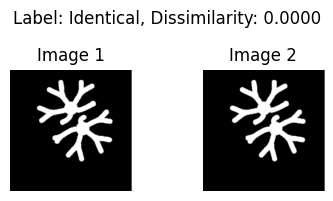

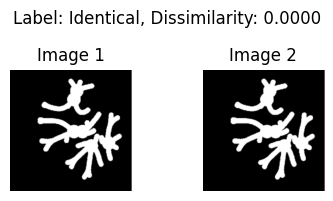

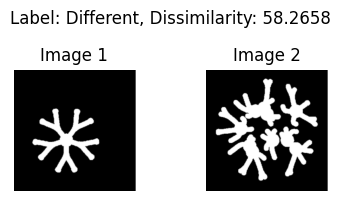

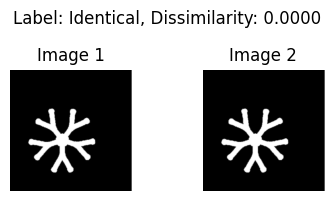

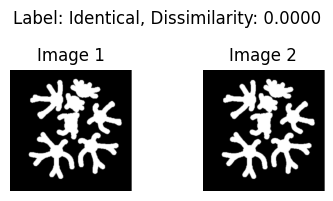

...

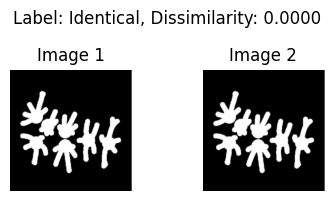

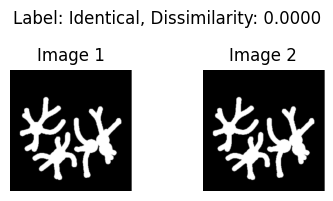

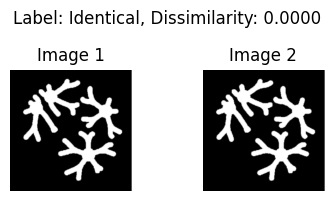

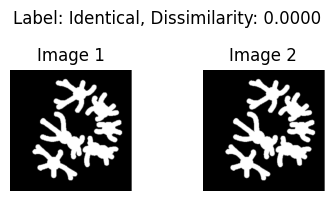

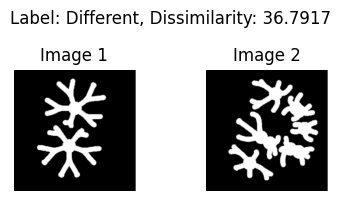

In [ ]:
# Generate balanced pairs from experimental data
sim_pairs, sim_labels = generate_pairs(alldata_sim, seed=0)

# Create Dataset and DataLoader
sim_dataset  = SiamesePairsDataset(sim_pairs, sim_labels , transform=transform)
sim_loader = DataLoader(sim_dataset , batch_size=32, shuffle=True)

# Plot results

plot_test_pairs(model, sim_loader, device, num_pairs=len(sim_loader.dataset.pairs))


## Prediction set

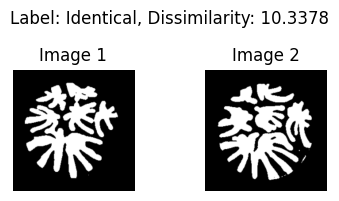

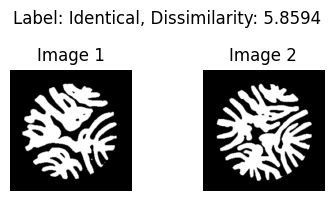

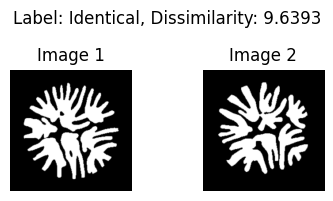

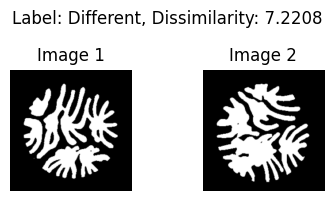

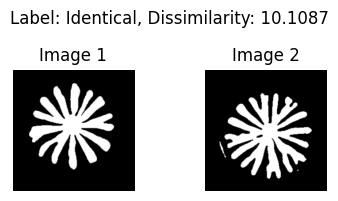

...

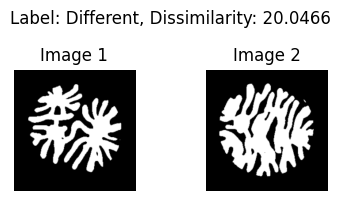

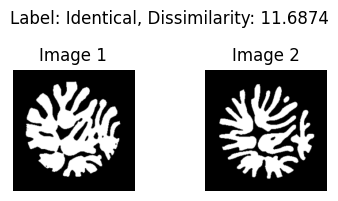

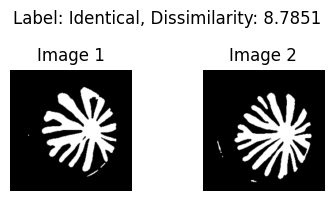

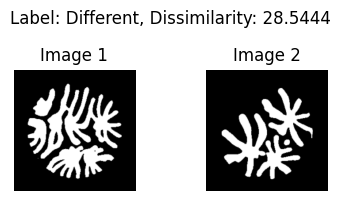

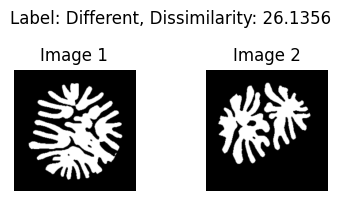

In [ ]:
# Generate balanced pairs from experimental data
pred_pairs, pred_labels = generate_pairs(alldata_pred, seed=0)

# Create Dataset and DataLoader
pred_dataset = SiamesePairsDataset(pred_pairs, pred_labels, transform=transform)
pred_loader = DataLoader(pred_dataset, batch_size=32, shuffle=True)

# Plot results
plot_test_pairs(model, pred_loader, device, num_pairs=len(pred_loader.dataset.pairs))



# Score histograms

In [ ]:
def get_scores_by_label(model, loader, device):
    model.eval()
    scores_label_0 = []
    scores_label_1 = []

    with torch.no_grad():
        for img1, img2, label in loader:
            img1, img2, label = img1.to(device), img2.to(device), label.to(device)
            out1, out2 = model(img1, img2)
            distances = F.pairwise_distance(out1, out2)

            for d, l in zip(distances.cpu().numpy(), label.cpu().numpy()):
                if int(l) == 1:
                    scores_label_1.append(d)
                else:
                    scores_label_0.append(d)

    return scores_label_0, scores_label_1

def plot_score_histograms(scores_0, scores_1, title, output_dir, bins=30):
    plt.figure(figsize=(5, 4))
    plt.hist(scores_0, bins=bins, alpha=0.7, label="Label 0 (dissimilar)", density=True)
    plt.hist(scores_1, bins=bins, alpha=0.7, label="Label 1 (identical)", density=True)
    plt.xlabel("Dissimilarity")
    plt.ylabel("Density")
    plt.title(f"{title}")
    plt.legend()
    plt.tight_layout()
    filename = os.path.join(output_dir, f"{title}.png")
    plt.savefig(filename)
    plt.show()


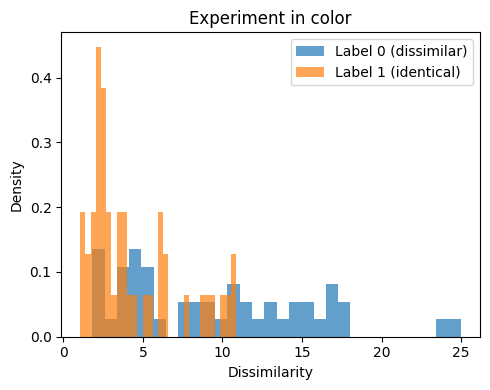

In [ ]:
# Experiment in colors
scores_0, scores_1 = get_scores_by_label(model, exp_loader_color, device)
plot_score_histograms(scores_0, scores_1, "Experiment in color", "/content/")


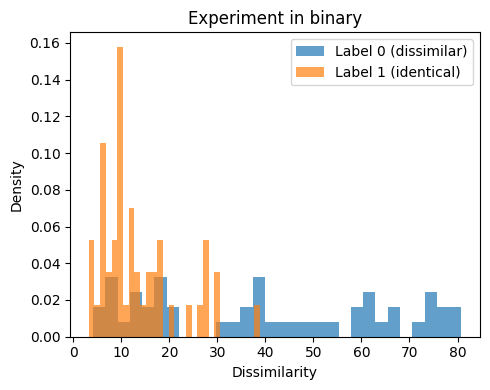

In [ ]:
# Experiment in binary
scores_0, scores_1 = get_scores_by_label(model, exp_loader, device)
plot_score_histograms(scores_0, scores_1, "Experiment in binary", "/content/")


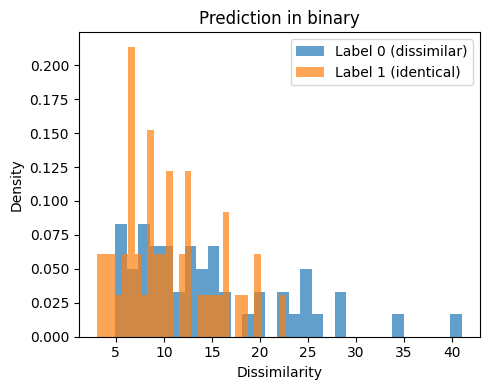

In [ ]:
# Prediction in binary
scores_0, scores_1 = get_scores_by_label(model, pred_loader, device)
plot_score_histograms(scores_0, scores_1, "Prediction in binary", "/content/")


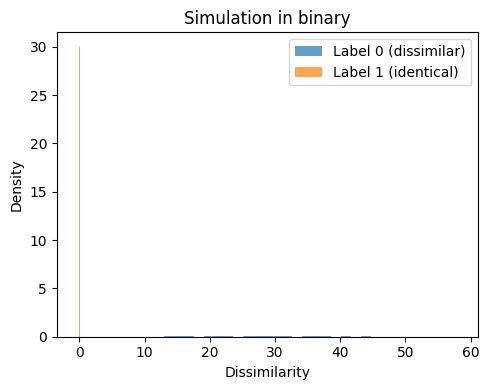

In [ ]:
# Simulation set
scores_0, scores_1 = get_scores_by_label(model, sim_loader, device)
# Plot
plot_score_histograms(scores_0, scores_1, "Simulation in binary", "/content/")


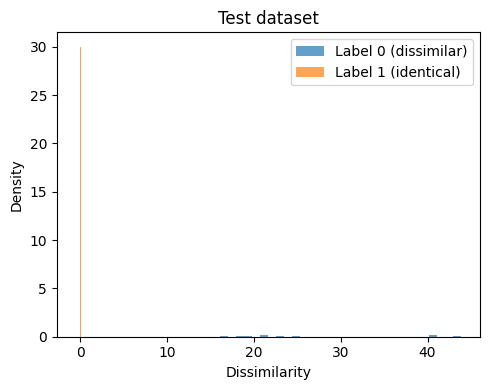

In [ ]:
# Test set
scores_0, scores_1 = get_scores_by_label(model, test_loader, device)
# Plot
plot_score_histograms(scores_0, scores_1, "Test dataset", "/content/")


# Compare prediction-experiments vs simulation-experiments

In [ ]:
# Generate image pairs, one from experiment, one from either prediction or simulation
class FixedPairDataset(Dataset):
    def __init__(self, exp_files, ref_files, transform=None, seed=42, image_size=(64, 64)):
        self.transform = transform
        self.image_size = image_size
        self.pairs = []

        # Group references by ExpID
        ref_group = defaultdict(list)
        for f in ref_files:
            expid = os.path.basename(f).split('_')[0]
            ref_group[expid].append(f)

        random.seed(seed)

        for exp_f in exp_files:
            expid = os.path.basename(exp_f).split('_')[0]
            if expid in ref_group and len(ref_group[expid]) > 0:
                ref_f = random.choice(ref_group[expid])
            else:
                ref_f = None  # Use dummy data

            self.pairs.append((ref_f, exp_f))

    def __len__(self):
        return len(self.pairs)

    def __getitem__(self, idx):
        f1, f2 = self.pairs[idx]

        img2 = Image.open(f2).convert('L')

        if f1 is None:
            # Create a dummy image (black image with same size) if f1 is missing from the folder
            img1 = Image.new('L', self.image_size, color=0)
            f1_name = "DUMMY_IMAGE.png"
        else:
            img1 = Image.open(f1).convert('L')
            f1_name = os.path.basename(f1)

        if self.transform:
            img1 = self.transform(img1)
            img2 = self.transform(img2)

        return img1, img2, f1_name, os.path.basename(f2)


In [ ]:
def compare_and_plot_by_index(model, sim_dataset, pred_dataset, device, output_dir, num_pairs=10):
    model.eval()
    sim_score_list = []
    pred_score_list = []

    print(f"Comparing up to {num_pairs} pairs (available: {len(sim_dataset)})")
    count = 0
    with torch.no_grad():
        for i in range(min(num_pairs, len(sim_dataset), len(pred_dataset))):
            img1_sim, img2_sim, name1_sim, name2_sim = sim_dataset[i]
            img1_pred, img2_pred, name1_pred, name2_pred = pred_dataset[i]

            # Skip mismatched experimental images (likely due to missing replicates)
            if name2_sim != name2_pred:
                print(f"[{i}] Skipping mismatched exp image: SIM = {name2_sim}, PRED = {name2_pred}")
                continue

            # Move to device
            img1_sim = img1_sim.unsqueeze(0).to(device)
            img2_sim = img2_sim.unsqueeze(0).to(device)
            img1_pred = img1_pred.unsqueeze(0).to(device)
            img2_pred = img2_pred.unsqueeze(0).to(device)

            # Compute distances
            out_sim1, out_sim2 = model(img1_sim, img2_sim)
            out_pred1, out_pred2 = model(img1_pred, img2_pred)

            d_sim = F.pairwise_distance(out_sim1, out_sim2).item()
            d_pred = F.pairwise_distance(out_pred1, out_pred2).item()
            if d_sim > d_pred: count += 1
            sim_score_list.append(d_sim)
            pred_score_list.append(d_pred)

            # Plot side by side
            fig, axs = plt.subplots(1, 3, figsize=(9, 3))

            axs[0].imshow(img1_sim.cpu().squeeze(), cmap='gray')
            axs[0].set_title(f"Sim vs Exp\nDissimilarity: {d_sim:.4f}\nref: {name1_sim}, exp: {name2_sim}")
            axs[0].axis('off')

            axs[1].imshow(img1_pred.cpu().squeeze(), cmap='gray')
            axs[1].set_title(f"Pred vs Exp\nDissimilarity: {d_pred:.4f}\nref: {name1_pred}, exp: {name2_pred}")
            axs[1].axis('off')

            axs[2].imshow(img2_pred.cpu().squeeze(), cmap='gray')
            axs[2].set_title(f"Exp: {name2_pred}")
            axs[2].axis('off')

            plt.suptitle(f"Experiment ID: {name2_sim.split('_')[0]}")
            plt.tight_layout()

            filename = os.path.join(output_dir, f"{i}_{name2_sim.replace('/', '_')}.png")
            plt.savefig(filename)

            plt.show()

    return sim_score_list, pred_score_list


Total exp images paired: 100 (sim), 100 (pred)
Comparing up to 100 pairs (available: 100)


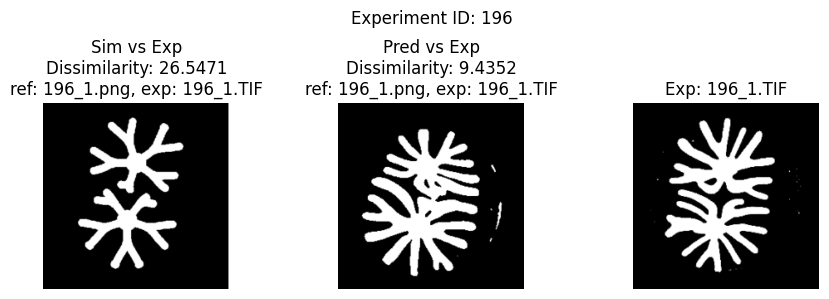

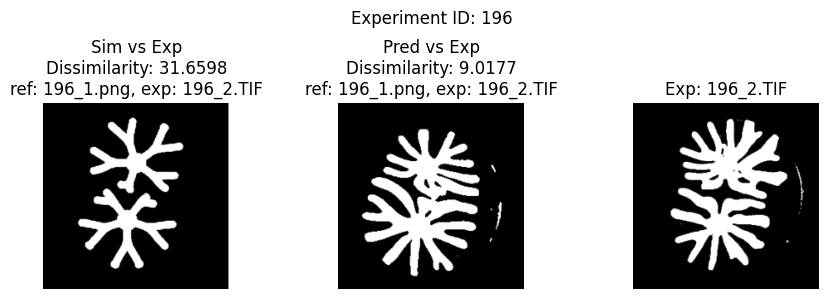

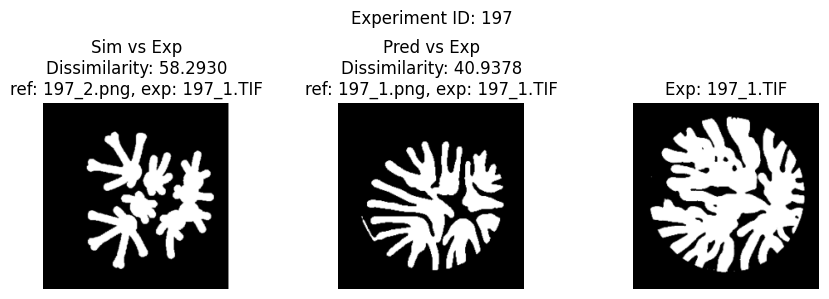

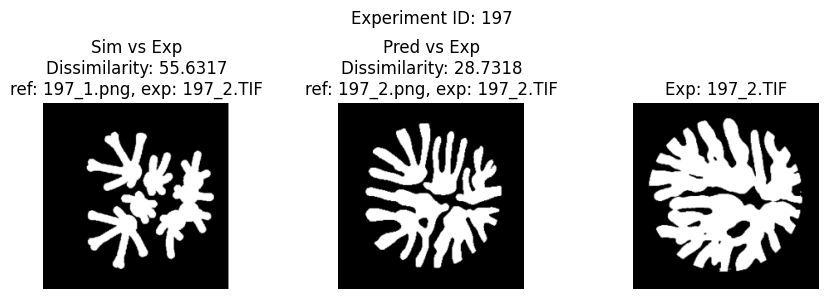

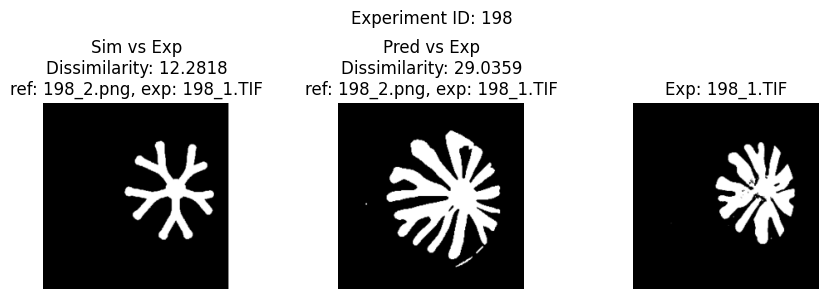

...

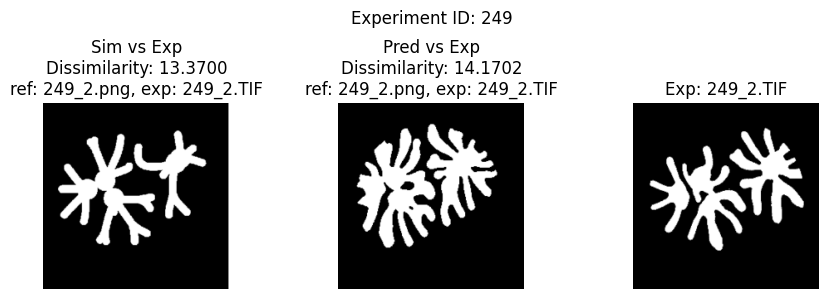

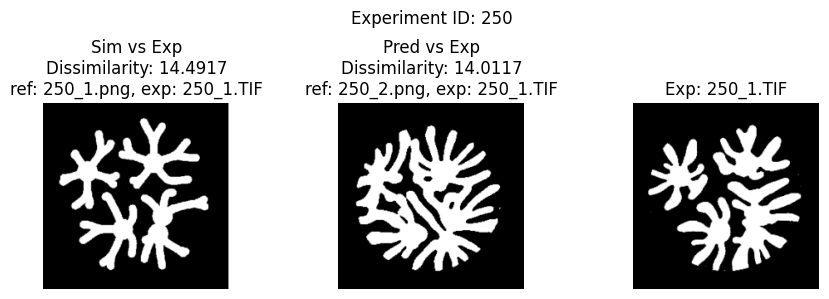

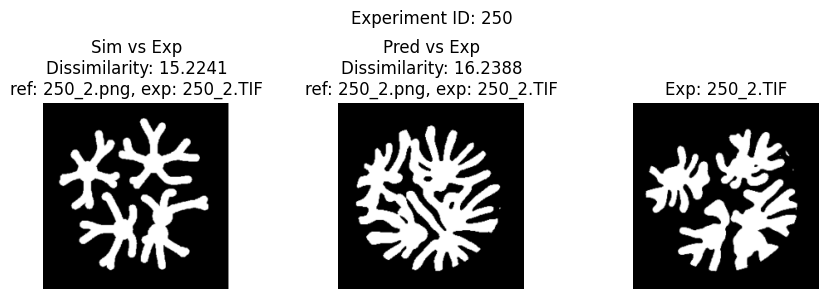

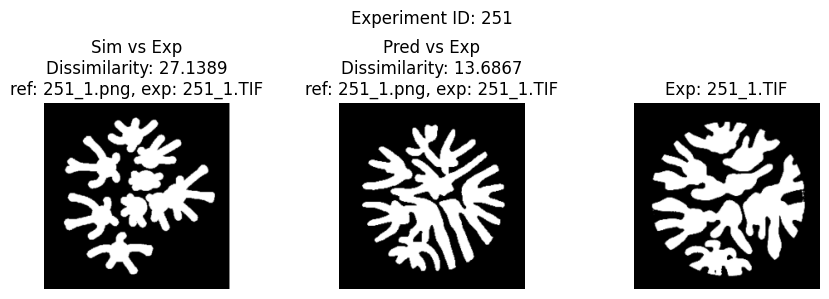

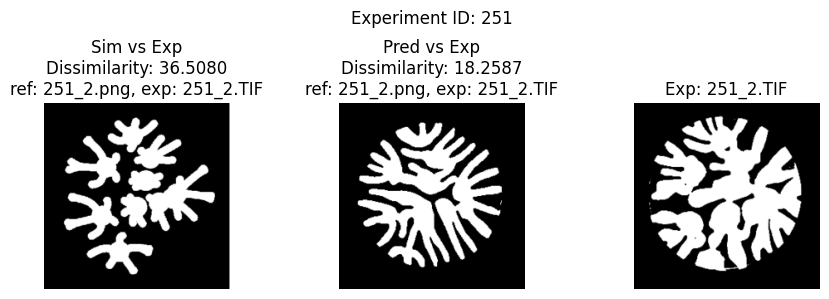

47


In [ ]:
# Ensure sorting for consistent order
alldata_exp_sorted = sorted(alldata_exp)
# Generate sim-exp and pred-exp image pairs
sim_exp_dataset = FixedPairDataset(exp_files=alldata_exp_sorted, ref_files=alldata_sim, transform=transform, seed=42)
pred_exp_dataset = FixedPairDataset(exp_files=alldata_exp_sorted, ref_files=alldata_pred, transform=transform, seed=42)

sim_exp_loader = DataLoader(sim_exp_dataset, batch_size=1, shuffle=False)
pred_exp_loader = DataLoader(pred_exp_dataset, batch_size=1, shuffle=False)

print(f"Total exp images paired: {len(sim_exp_loader)} (sim), {len(pred_exp_loader)} (pred)")
output_dir = "/content/gdrive/MyDrive/DissimilarityScore_Seeding/results/"
os.makedirs(output_dir, exist_ok=True)
# For each exp image, compare similarity with a simulation and a prediction image that are randomly pooled
sim_score_list, pred_score_list = compare_and_plot_by_index(model, sim_exp_dataset, pred_exp_dataset, device, output_dir, num_pairs=len(sim_exp_loader))


Count where sim_score > pred_score or ~equal (within 0.05): 47 out of 100


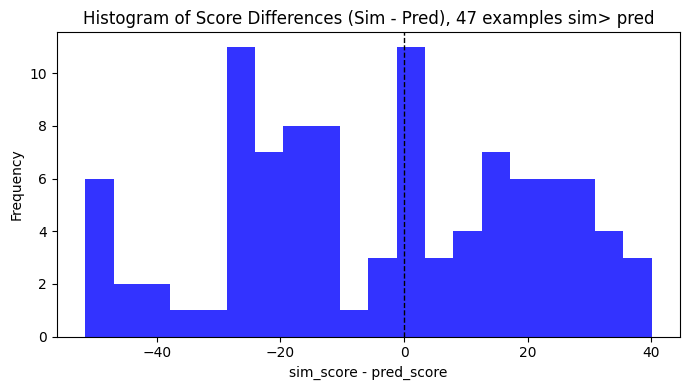

In [ ]:
# Plot the histograms of distance differences
diff_list = [sim_score_list[i] - pred_score_list[i] for i in range(len(pred_score_list))]
count_sim_greater_or_close = sum(
    (sim > pred) or abs(sim - pred) < 0.05
    for sim, pred in zip(sim_score_list, pred_score_list)
)
print(f"Count where sim_score > pred_score or ~equal (within 0.05): {count_sim_greater_or_close} out of {len(sim_score_list)}")


plt.figure(figsize=(7, 4))
plt.hist(diff_list, bins=20, color='blue', alpha=0.8)
plt.axvline(x=0, color='black', linestyle='--', linewidth=1)
plt.xlabel("sim_score - pred_score")
plt.ylabel("Frequency")
plt.title(f"Histogram of Score Differences (Sim - Pred), {count_sim_greater_or_close} examples sim> pred")
plt.tight_layout()
# plt.xlim(-2,2)
fileame=os.path.join("/content/", "sim-pred_hist.png")
plt.savefig(fileame)
plt.show()
